# Multivariate motif identification in STUMPY

## Load ohlcv dataframe

This part just loads ohlcv_df dataframe from local cache. Replace by your data.


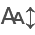

trades_df-BAC-2024-01-01T09_30_00-2024-05-14T16_00_00-CO4B7VPWUZF-100.parquet
trades_df-BAC-2024-01-11T09:30:00-2024-01-12T16:00:00.parquet
trades_df-SPY-2024-01-01T09:30:00-2024-05-14T16:00:00.parquet
trades_df-BAC-2023-01-01T09_30_00-2024-05-25T16_00_00-47BCFOPUVWZ-100.parquet
ohlcv_df-BAC-2024-01-11T09:30:00-2024-01-12T16:00:00.parquet
trades_df-BAC-2024-05-15T09_30_00-2024-05-25T16_00_00-47BCFOPUVWZ-100.parquet
ohlcv_df-BAC-2024-01-01T09_30_00-2024-05-25T16_00_00-47BCFOPUVWZ-100.parquet
ohlcv_df-SPY-2024-01-01T09:30:00-2024-05-14T16:00:00.parquet
ohlcv_df-BAC-2024-01-01T09_30_00-2024-05-14T16_00_00-CO4B7VPWUZF-100.parquet
ohlcv_df-BAC-2023-01-01T09_30_00-2024-05-25T16_00_00-47BCFOPUVWZ-100.parquet
ohlcv_df-BAC-2023-01-01T09_30_00-2024-05-25T15_30_00-47BCFOPUVWZ-100.parquet


In [1]:
import pandas as pd
import numpy as np
from itables import init_notebook_mode, show
import datetime
from itertools import product
from appdirs import user_data_dir

init_notebook_mode(all_interactive=True)

#LOAD FROM PARQUET
DATA_DIR = user_data_dir("v2realbot", False)
dir = DATA_DIR + "/notebooks/"
import os
files = [f for f in os.listdir(dir) if f.endswith(".parquet")]
print('\n'.join(map(str, files)))
file_name = "ohlcv_df-BAC-2023-01-01T09_30_00-2024-05-25T15_30_00-47BCFOPUVWZ-100.parquet"
ohlcv_df = pd.read_parquet(dir+file_name,engine='pyarrow')
#filter ohlcv_df to certain date range (assuming datetime index)
ohlcv_df = ohlcv_df.loc["2024-02-12 9:30":"2024-02-14 16:00"]


## Calculate matrix profile of given length
* Multivariate timeseries (OHLCV)
* motif length

In [27]:
import numpy as np
import stumpy
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
# The length of the motif
m = 100

# Convert OHLCV dataframe to numpy array (each column is a separate time series)
ohlcv_data = ohlcv_df[['open', 'high', 'low', 'close', 'volume']].values.T
ohlcv_data = ohlcv_df['close']
time_series = ohlcv_data

#time_series.info()
# Compute the multivariate matrix profile for motif discovery
# indices represent the starting positions of the nearest motif pairs in your multivariate time series.
mp = stumpy.stump(time_series.values, m)
     

## animation


In [8]:
mp

mparray([[1.4957263269791667, 6756, -1, 6756],
         [1.5501323593652483, 6757, -1, 6757],
         [1.7639444257134822, 23870, -1, 23870],
         ...,
         [2.0088422637346133, 16160, 16160, -1],
         [2.0088422637346133, 16161, 16161, -1],
         [2.5964871812945947, 33070, 33070, -1]], dtype=object)

In [28]:
# Extract the motif indices from the matrix profile
motif_idx = np.argmin(mp[:, 0])
nearest_neighbor_idx = mp[motif_idx, 1]

# Step 5: Prepare for animation visualization
fig, ax = plt.subplots()
ax.set_title("Motif Identification in Time Series (Close Prices)")
ax.set_xlabel("Date")
ax.set_ylabel("Close Price")
line, = ax.plot(time_series.index, time_series.values, lw=2, label="Close Prices", alpha=0.7)
motif_line1, = ax.plot([], [], lw=2, label="Motif 1", color='r')
motif_line2, = ax.plot([], [], lw=2, label="Motif 2", color='g')
ax.legend()

# Step 6: Update function for animation
def update(i):
    # Update motif lines over the full time series
    motif_start1 = motif_idx
    motif_start2 = nearest_neighbor_idx
    
    # Animate the motif from start to i-th frame across the entire series
    motif_line1.set_data(time_series.index[motif_start1:motif_start1 + i],
                         time_series.values[motif_start1:motif_start1 + i])
    motif_line2.set_data(time_series.index[motif_start2:motif_start2 + i],
                         time_series.values[motif_start2:motif_start2 + i])

    return motif_line1, motif_line2

# Step 7: Create animation over the full time series
ani = FuncAnimation(fig, update, frames=np.arange(1, len(time_series) - m), interval=100, blit=True)

# Step 8: Display the animation using HTML in Jupyter
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Animation size has reached 21012984 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


### simple visualization

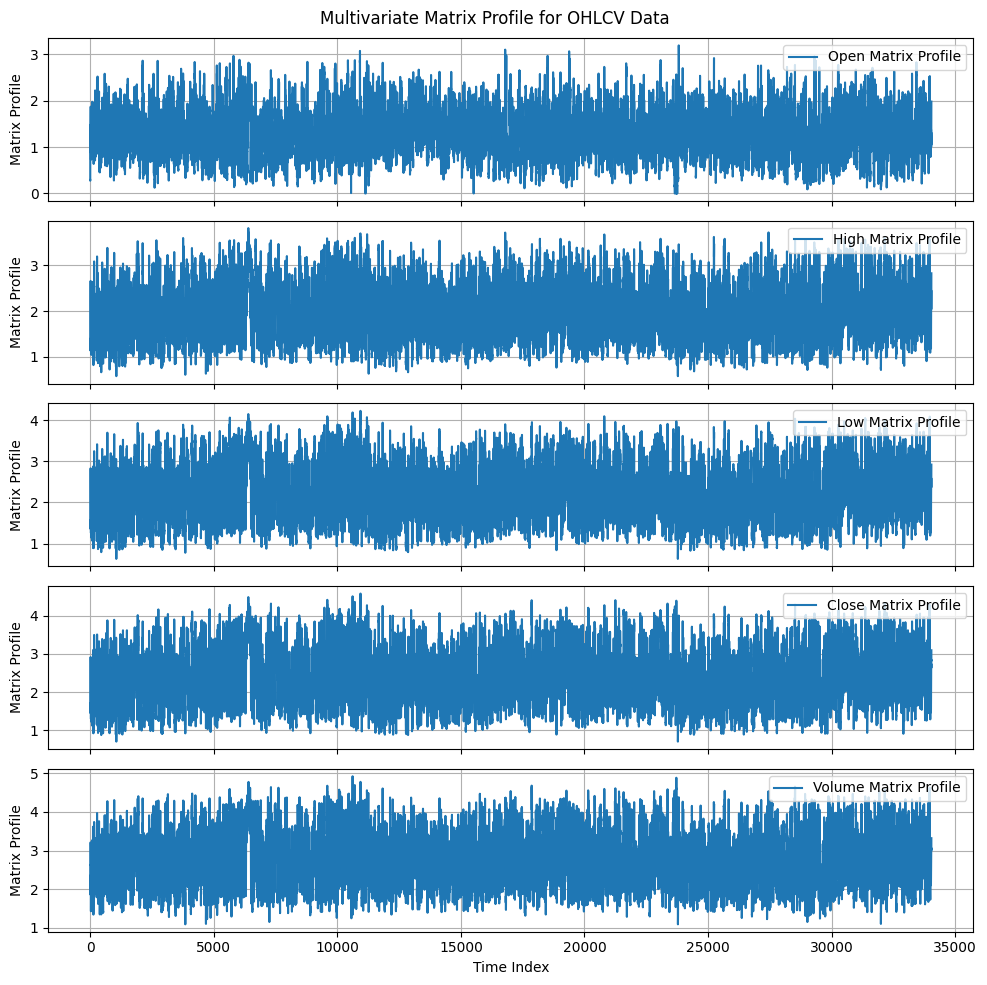

In [4]:
import matplotlib.pyplot as plt
%matplotlib inline

# Assume matrix_profile is a 2D array where each row corresponds to a time series variable (OHLCV)
# and each column is the matrix profile value for that variable at a given time index.

# Plot each time series' matrix profile
fig, axes = plt.subplots(nrows=matrix_profile.shape[0], ncols=1, figsize=(10, 10), sharex=True)

# Titles for the subplots corresponding to each OHLCV component
labels = ['Open', 'High', 'Low', 'Close', 'Volume']

for i in range(matrix_profile.shape[0]):
    axes[i].plot(matrix_profile[i], label=f'{labels[i]} Matrix Profile')
    axes[i].legend(loc="upper right")
    axes[i].set_ylabel('Matrix Profile')
    axes[i].grid(True)

plt.xlabel('Time Index')
plt.suptitle('Multivariate Matrix Profile for OHLCV Data')
plt.tight_layout()
plt.show()


## More interactive visualization

In [5]:
import plotly.graph_objects as go

# Create a figure
fig = go.Figure()

# Add traces for each time series component in OHLCV
for i, label in enumerate(['Open', 'High', 'Low', 'Close', 'Volume']):
    fig.add_trace(go.Scatter(
        y=matrix_profile[i],
        mode='lines',
        name=f'{label} Matrix Profile'
    ))

# Update layout
fig.update_layout(
    title="Multivariate Matrix Profile for OHLCV Data",
    xaxis_title="Time Index",
    yaxis_title="Matrix Profile",
    hovermode="x unified"
)

# Show the figure
fig.show()


## subsequences visualization

To display all identified subsequences (motifs) across all time series components from the most obvious to the least, we can follow these steps:

Steps:
* Sort the motifs: Based on the matrix profile values (lower values indicate stronger motifs), sort the subsequences from most obvious to least.
* Extract subsequences: For each time series (e.g., open, high, low, close, volume), extract the corresponding motifs.
* Visualize the motifs: For each time series, plot the motifs, displaying both the most obvious and the least obvious subsequences.


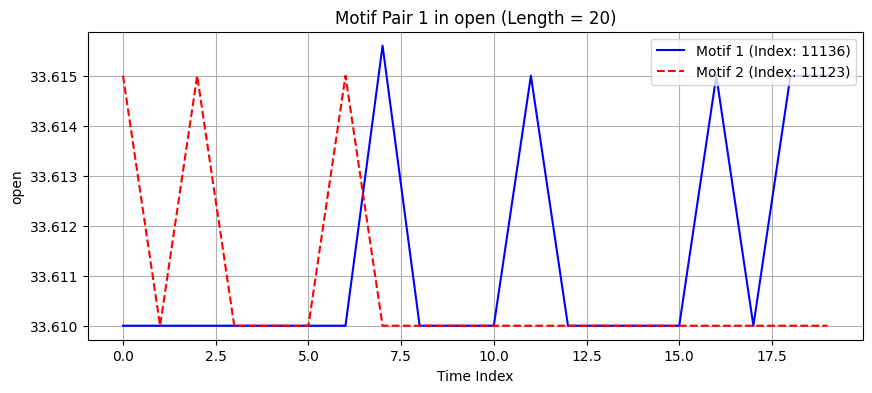

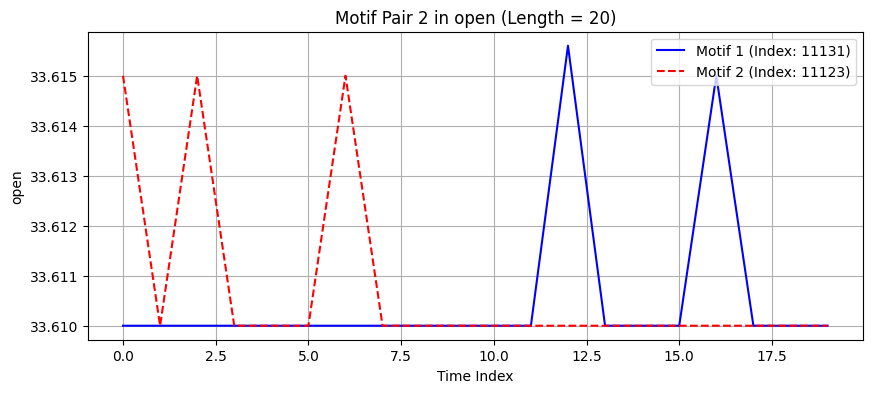

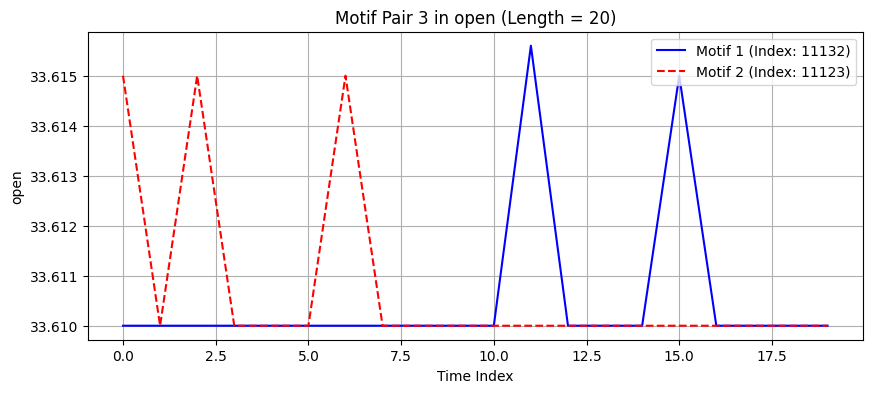

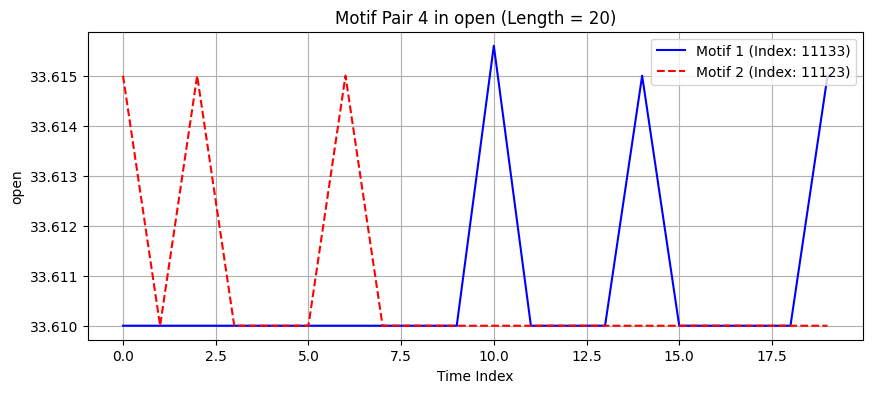

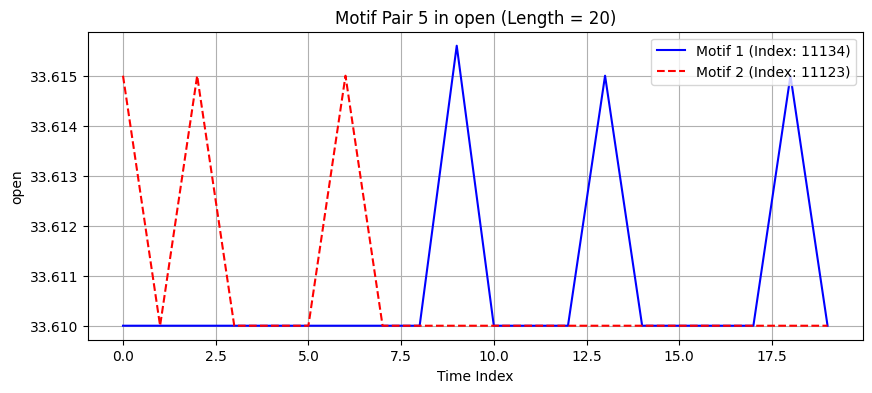

...

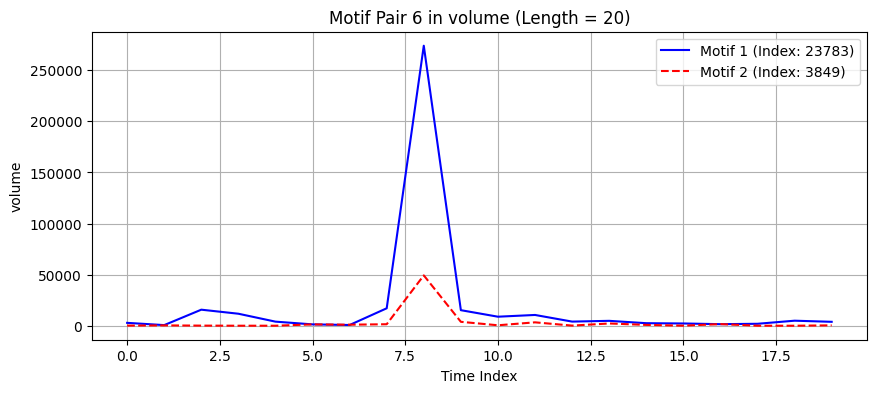

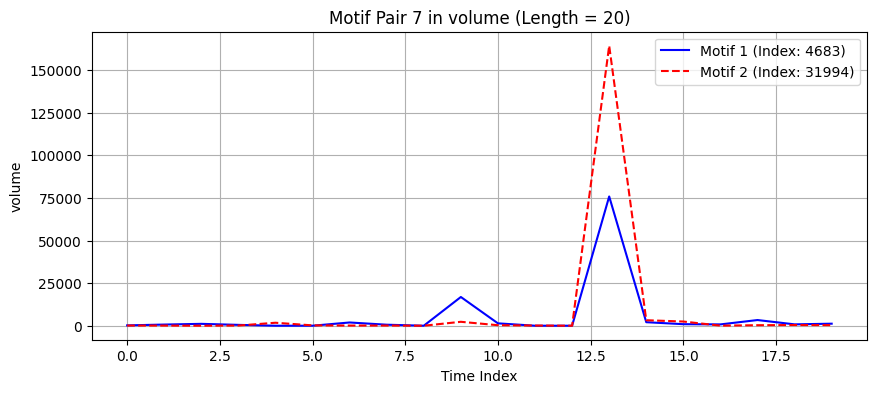

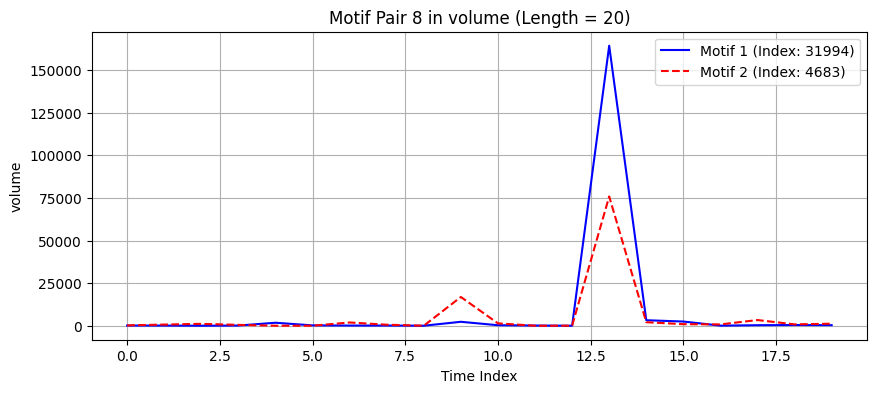

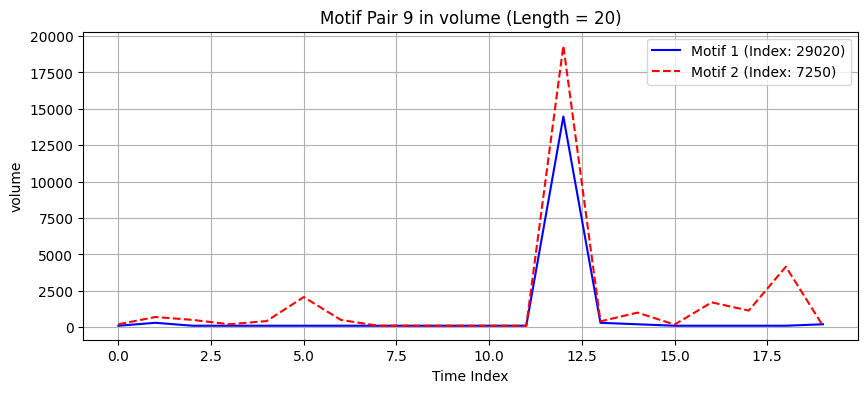

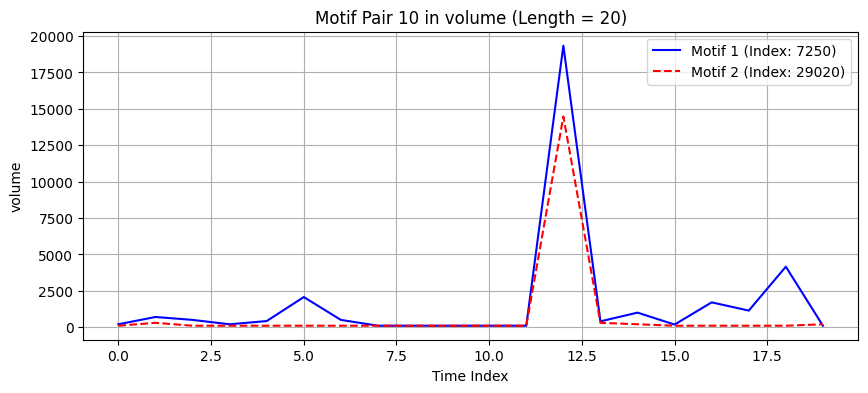

In [7]:
import matplotlib.pyplot as plt
import numpy as np

# Titles for each OHLCV component
labels = ['open', 'high', 'low', 'close', 'volume']

# Sort motifs based on matrix profile values (lower values indicate more obvious motifs)
# We will process each variable one by one.
for var_index, label in enumerate(labels):
    
    # Get the matrix profile and indices for this specific variable
    mp_values = matrix_profile[var_index]
    mp_indices = indices[var_index]
    
    # Sort indices by matrix profile values (ascending order to show most obvious motifs first)
    sorted_indices = np.argsort(mp_values)
    
    # Now loop over sorted motifs and display them - max 10
    for motif_rank, motif_idx_1 in enumerate(sorted_indices[:10]):
        
        if mp_values[motif_idx_1] == np.inf:  # Stop when there are no more valid motifs
            break
        
        motif_idx_2 = mp_indices[motif_idx_1]  # Get the index of the most similar motif
        
        # Extract the subsequences (motifs) from the original time series
        motif_1 = ohlcv_df[label].values[motif_idx_1:motif_idx_1 + m]
        motif_2 = ohlcv_df[label].values[motif_idx_2:motif_idx_2 + m]
        
        # Plot the motif pair
        plt.figure(figsize=(10, 4))
        plt.plot(motif_1, label=f'Motif 1 (Index: {motif_idx_1})', color='blue')
        plt.plot(motif_2, label=f'Motif 2 (Index: {motif_idx_2})', color='red', linestyle='--')
        plt.title(f'Motif Pair {motif_rank + 1} in {label} (Length = {m})')
        plt.legend(loc='upper right')
        plt.xlabel('Time Index')
        plt.ylabel(label)
        plt.grid(True)
        plt.show()
